In [1]:
from sklearn.metrics import classification_report, confusion_matrix
from skimage.metrics import structural_similarity as ssim
from sklearn import preprocessing
from keras.utils import to_categorical
from keras import regularizers
from keras.models import Model
from keras.callbacks import ModelCheckpoint
from keras.layers import Input, Conv2D, Activation, MaxPooling2D, Flatten, Dense, Dropout
from keras.src.legacy.preprocessing.image import ImageDataGenerator

import random
import re
import glob
from tqdm import tqdm
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import time
import gc

2025-02-26 18:35:44.080050: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-02-26 18:35:44.091484: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-02-26 18:35:44.095957: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-26 18:35:44.108428: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"GPUs disponíveis: {gpus}")
else:
    print("Nenhuma GPU encontrada.")

GPUs disponíveis: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


I0000 00:00:1740605746.699950    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740605746.803614    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740605746.804105    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.


In [3]:
# nome = 'PACS'
nome = 'Yildirim'
#nome = 'Todos'

imgs_path = 'Bases/Dataset' + nome

TEST_SIZE = 0.1
VALIDATION_SIZE = 0.1

SIMILARITY = 0.75

EPOCHS = 200
BATCH_SIZE = 32

HIGH_FREQ_THRESHOLD = 50

NOISE_FRACTION = 0.05
NOISE_LEVEL = 0.05

# NOISE_FRACTION = 0.50
# NOISE_LEVEL = 0.50

In [4]:
def get_next_filename(output_folder, base_name, type):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    image_index = 0
    
    while True:
        output_filename = f"{base_name}_{image_index}.{type}"
        output_path = os.path.join(output_folder, output_filename)
        
        if not os.path.exists(output_path):
            return output_filename
            
        image_index += 1

In [5]:
def extract_number(filename):
    match = re.search(r'(\d+)', filename)
    return int(match.group(0)) if match else 0

In [6]:
def sort_files_numerically(file_paths):
    return sorted(file_paths, key=lambda x: extract_number(x))

In [7]:
def find_groups(images, image_paths, test_size, similarity_threshold):
    def are_similar(img1, img2, threshold):
        similarity = ssim(img1, img2)
        return similarity >= threshold

    groups = []
    current_group = [image_paths[0]]

    for i in range(1, len(images)):
        if are_similar(images[i-1], images[i], similarity_threshold):
            current_group.append(image_paths[i])
        else:
            groups.append(current_group)
            current_group = [image_paths[i]]
    
    if current_group:
        groups.append(current_group)

    all_images = [img_path for group in groups for img_path in group]

    for img_path in image_paths:
        if img_path not in all_images:
            groups.append([img_path])

    random.shuffle(groups)

    train_set = []
    test_set = []
    current_test_size = 0
    
    for i, group in enumerate(groups):
        if current_test_size + len(group) <= test_size:
            test_set.extend(group)
            current_test_size += len(group)
        else:
            train_set.extend(group)

    return train_set, test_set

In [8]:
output_folder = 'Groups'
type = 'txt'

def save_groups(train_groups, test_groups, base_name):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    with open(output_path, 'w') as file:
        file.write('- test:\n')
        for idx, group in enumerate(test_groups, start=1):
            for img in group:
                file.write(f"{img}\n")
        
        file.write('- train:\n')
        for idx, group in enumerate(train_groups, start=1):
            for img in group:
                file.write(f'{img}\n')
    
    print(f'Group information saved in {output_path}')

In [9]:
def read_dataset(path, jpg, png):
    print(f'Reading dataset...\n')
    
    img_type = []
    images = []
    image_paths = []

    if jpg:
        img_type.append('*.jpg')
    if png:
        img_type.append('*.png')

# Normal
    
    normal_path = os.path.join(path, 'Train', 'Normal')
    normal_images = []
    normal_image_paths = []
    print(f'Reading Normal images from: {normal_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(normal_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            normal_images.append(img)
            normal_image_paths.append(img_path)

    normal_images = np.array(normal_images)
    normal_image_paths = np.array(normal_image_paths)

# Normal Groups

    normal_total_images = len(normal_images)
    normal_test_size = int(normal_total_images * TEST_SIZE)

    print(f'Total number of normal images: {normal_total_images}')
    print(f'Calculated normal test size: {normal_test_size}')

    normal_train_set, normal_test_set = find_groups(normal_images, normal_image_paths, normal_test_size, SIMILARITY)

    print(f'Number of normal images in train set: {len(normal_train_set)}')
    print(f'Number of normal images in test set: {len(normal_test_set)}\n')

# Kidney
    
    kidney_stone_path = os.path.join(path, 'Train', 'Kidney_stone')
    kidney_stone_images = []
    kidney_stone_image_paths = []
    print(f'Reading Kidney_stone images from: {kidney_stone_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(kidney_stone_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            kidney_stone_images.append(img)
            kidney_stone_image_paths.append(img_path)

    kidney_stone_images = np.array(kidney_stone_images)
    kidney_stone_image_paths = np.array(kidney_stone_image_paths)

# Kidney Groups
    
    kidney_stone_total_images = len(kidney_stone_images)
    kidney_stone_test_size = int(kidney_stone_total_images * TEST_SIZE)

    print(f'Total number of kidney images: {kidney_stone_total_images}')
    print(f'Calculated kidney test size: {kidney_stone_test_size}')

    kidney_stone_train_set, kidney_stone_test_set = find_groups(kidney_stone_images, kidney_stone_image_paths, kidney_stone_test_size, SIMILARITY)
    
    train_groups = [normal_train_set, kidney_stone_train_set]
    test_groups = [normal_test_set, kidney_stone_test_set]
    
    output_folder = 'Groups'
    base_name = 'groups_' + nome
    save_groups(train_groups, test_groups, base_name)

    print(f'Number of kidney images in train set: {len(kidney_stone_train_set)}')
    print(f'Number of kidney images in test set: {len(kidney_stone_test_set)}')

# ...
    
    X_train = []
    X_test = []

    for img_path in normal_train_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_train.append(normal_images[idx])

    for img_path in normal_test_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_test.append(normal_images[idx])

    for img_path in kidney_stone_train_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_train.append(kidney_stone_images[idx])

    for img_path in kidney_stone_test_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_test.append(kidney_stone_images[idx])

    X_train = np.array(X_train)
    X_test = np.array(X_test)

    return X_train, X_test

In [10]:
X_train, X_test = read_dataset(path=imgs_path, jpg=True, png=True)

Reading dataset...

Reading Normal images from: Bases/DatasetYildirim/Train/Normal
Total number of normal images: 1009
Calculated normal test size: 100
Number of normal images in train set: 909
Number of normal images in test set: 100

Reading Kidney_stone images from: Bases/DatasetYildirim/Train/Kidney_stone
Total number of kidney images: 790
Calculated kidney test size: 79
Group information saved in Groups/groups_Yildirim_9.txt
Number of kidney images in train set: 711
Number of kidney images in test set: 79


In [11]:
X_train_orig = X_train.copy()
X_test_orig = X_test.copy()

In [12]:
def high_freq_spec(image, threshold):
# Transformada de Fourier
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)
    
# Altas frequências
    rows, cols = image.shape
    crow, ccol = rows//2, cols//2
    mask_high = np.ones((rows, cols), np.uint8)
    mask_high[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = 0  # Remove as baixas frequências
    
# Espectro
    fshift_high = fshift * mask_high
    magnitude_spectrum_high = 20 * np.log(np.abs(fshift_high) + 1)
    
    return magnitude_spectrum_high

In [13]:
def save_specs(images, threshold):
    specs = []
    for img in images:
        specs.append(high_freq_spec(img, threshold))
    return specs

In [14]:
len_normal_train_specs = int(len(X_train_orig) / 2)
len_normal_test_specs = int(len(X_test_orig) / 2)

In [15]:
normal_train_specs = X_train_orig[0:len_normal_train_specs]
normal_test_specs = X_test_orig[0:len_normal_test_specs]

In [16]:
normal_train_specs = save_specs(normal_train_specs, HIGH_FREQ_THRESHOLD)
normal_test_specs = save_specs(normal_test_specs, HIGH_FREQ_THRESHOLD)

In [17]:
print(len(normal_train_specs))
print(len(normal_test_specs))

810
89


In [18]:
hacked_train_specs = X_train_orig[len_normal_train_specs:len(X_train_orig)]
hacked_test_specs = X_test_orig[len_normal_test_specs:len(X_test_orig)]

In [19]:
hacked_train_specs = save_specs(hacked_train_specs, HIGH_FREQ_THRESHOLD)
hacked_test_specs = save_specs(hacked_test_specs, HIGH_FREQ_THRESHOLD)

In [20]:
print(len(hacked_train_specs))
print(len(hacked_test_specs))

810
90


In [21]:
def plot_specs(specs, title):
    total_images = len(specs)
    imgs_per_figure = 100
    cols = 5
    rows = (imgs_per_figure + cols - 1) // cols

    for start in range(0, total_images, imgs_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + imgs_per_figure, total_images)
        
        for i in range(start, end):
            # Espectro de Altas Frequências
            plt.subplot(rows, cols, i - start + 1)
            plt.imshow(specs[i], cmap='gray')
            plt.title(f"{title} - high freq spec: img {i+1}")
            plt.axis('off')
            
        plt.tight_layout()
        plt.show()

In [22]:
# Plotar todos os espectros de treino
#plot_specs(normal_train_specs, title="train")

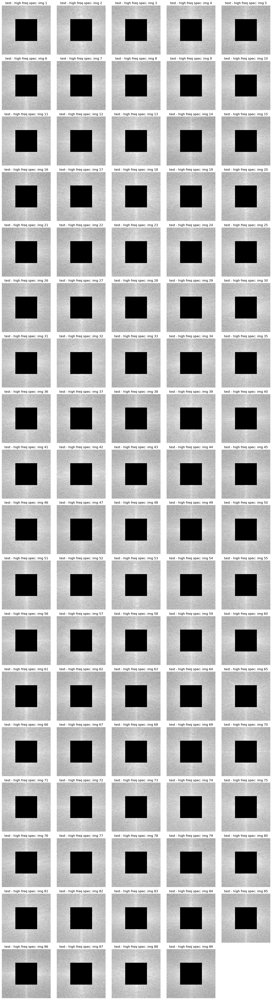

In [23]:
# Plotar todos os espectros de teste
plot_specs(normal_test_specs, title="test")

In [24]:
#pausa de teste

In [25]:
# SIMULAÇÃO DE RUÍDO

# Ruído Glaussiano
def add_high_freq_noise(image, threshold, noise_level, noise_fraction):
# Transformada de Fourier
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)
    
# Criar máscara de altas frequências
    rows, cols = image.shape
    crow, ccol = rows//2, cols//2
    mask_high = np.ones((rows, cols), dtype=bool)
    mask_high[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = False
    
# Selecionar 5% das coordenadas nas altas frequências
    high_freq_coords = np.where(mask_high)
    num_pixels = int(noise_fraction * rows * cols)
    
    if len(high_freq_coords[0]) == 0 or num_pixels == 0:
        return image
    
# Garantir que não exceda o número de pixels disponíveis
    num_samples = min(num_pixels, len(high_freq_coords[0]))
    indices = np.random.choice(len(high_freq_coords[0]), num_samples, replace=False)
    selected_coords = (high_freq_coords[0][indices], high_freq_coords[1][indices])
    
# Gerar ruído complexo
    sigma = noise_level * 255
    noise = np.random.normal(0, sigma, selected_coords[0].size) + 1j * np.random.normal(0, sigma, selected_coords[0].size)
    
# Aplicar ruído nas frequências selecionadas
    fshift[selected_coords] += noise
    
# Transformada inversa
    f_ishift = np.fft.ifftshift(fshift)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back).clip(0, 255).astype(np.uint8)
    
    return img_back

def add_high_freq_noise_to_images(images, threshold, noise_level, noise_fraction):
    return [add_high_freq_noise(img, threshold, noise_level, noise_fraction) for img in images]

hacked_train_specs = add_high_freq_noise_to_images(hacked_train_specs, HIGH_FREQ_THRESHOLD, NOISE_LEVEL, NOISE_FRACTION)
hacked_test_specs = add_high_freq_noise_to_images(hacked_test_specs, HIGH_FREQ_THRESHOLD, NOISE_LEVEL, NOISE_FRACTION)

# Labels:
normal_train_labels = np.zeros(len(normal_train_specs), dtype=bool)
hacked_train_labels = np.ones(len(hacked_train_specs), dtype=bool)

normal_test_labels = np.zeros(len(normal_test_specs), dtype=bool)
hacked_test_labels = np.ones(len(hacked_test_specs), dtype=bool)

# Combina os espectros
all_train_specs = np.concatenate((normal_train_specs, hacked_train_specs), axis=0)
all_train_labels = np.concatenate((normal_train_labels, hacked_train_labels))

all_test_specs = np.concatenate((normal_test_specs, hacked_test_specs), axis=0)
all_test_labels = np.concatenate((normal_test_labels, hacked_test_labels))

print("Tamanho do conjunto de treino:", all_train_specs.shape)
print("Tamanho do conjunto de teste:", all_test_specs.shape)
print("Exemplo dos labels de treino (False = original, True = com ruído):", all_train_labels)

Tamanho do conjunto de treino: (1620, 224, 224)
Tamanho do conjunto de teste: (179, 224, 224)
Exemplo dos labels de treino (False = original, True = com ruído): [False False False ...  True  True  True]


In [26]:
# Plotar todos os espectros de treino com ruído
#plot_specs(hacked_train_specs, title="train *")

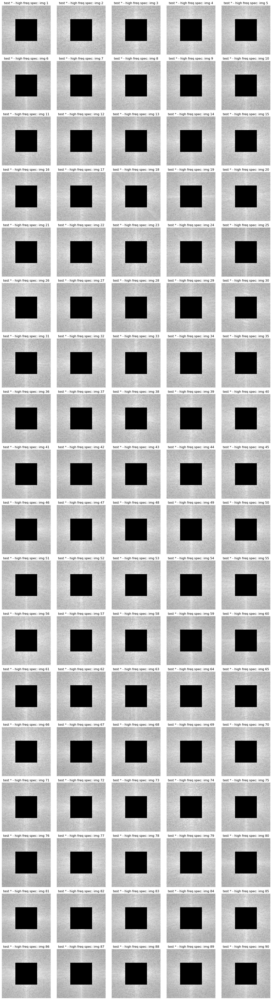

In [27]:
# Plotar todos os espectros de teste com ruído
plot_specs(hacked_test_specs, title="test *")

In [28]:
#pausa de teste

In [29]:
# Pré-processamento dos dados: adiciona dimensão do canal
all_train_specs = np.expand_dims(all_train_specs, axis=-1)
all_test_specs = np.expand_dims(all_test_specs, axis=-1)

# Converte os labels para o formato one-hot
all_train_labels_cat = to_categorical(all_train_labels.astype(int), num_classes=2)
all_test_labels_cat = to_categorical(all_test_labels.astype(int), num_classes=2)

In [30]:
# Defines the model layers
def model_conv4():
    inputs = Input(shape=(224, 224, 1))

    x = Conv2D(filters=16, kernel_size=(3,3), padding='valid')(inputs)
    x = Activation('relu')(x)
    x = MaxPooling2D(pool_size=(2,2), padding='valid')(x)
    
    x = Conv2D(filters=32, kernel_size=(3,3), padding='valid')(x)
    x = Activation('relu')(x)
    x = MaxPooling2D(pool_size=(2,2), padding='valid')(x)
    
    x = Conv2D(filters=64, kernel_size=(3,3), padding='valid')(x)
    x = Activation('relu')(x)
    x = MaxPooling2D(pool_size=(2,2), padding='valid')(x)

    x = Conv2D(filters=64, kernel_size=(3,3), padding='valid', name='last_conv')(x)
    x = Activation('relu')(x)
    x = MaxPooling2D(pool_size=(2,2), padding='valid')(x)

    x = Flatten()(x)

    x = Dense(units=150, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)

    x = Dense(units=100, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)

    outputs = Dense(units=2, activation='softmax')(x)

    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

    return model

In [31]:
# Create model
model = model_conv4()

I0000 00:00:1740605827.408549    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740605827.408662    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740605827.408715    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740605827.566324    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740605827.566463    6034 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-02-26

In [32]:
# Print the model summary
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 222, 222, 16)   │           160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 222, 222, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 109, 109, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 52, 52, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ last_conv (Conv2D)              │ (None, 24, 24, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 24, 24, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 12, 12, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 9216)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 150)            │     1,382,550 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 150)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 100)            │        15,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 2)              │           202 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,458,076 (5.56 MB)

 Trainable params: 1,458,076 (5.56 MB)

 Non-trainable params: 0 (0.00 B)

In [33]:
# Defines local to save the model results
output_folder = 'Models_saves'
base_name = 'model_' + nome
type = 'keras'

model_filepath = os.path.join(output_folder, get_next_filename(output_folder, base_name, type))
checkpoint = ModelCheckpoint(filepath=model_filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [34]:
start_time = time.time()

In [35]:
# Train the model
history = model.fit(
    all_train_specs, all_train_labels_cat,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=(all_test_specs, all_test_labels_cat),
    steps_per_epoch=len(all_train_specs) // BATCH_SIZE,
    callbacks=[checkpoint],
    verbose=1
)

Epoch 1/200


I0000 00:00:1740605833.565656    6102 service.cc:146] XLA service 0x7fa97c003110 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1740605833.565794    6102 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2025-02-26 18:37:13.609935: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-02-26 18:37:13.754885: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 90101


 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4933 - loss: 23.0302

I0000 00:00:1740605837.768529    6102 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4973 - loss: 10.6767
Epoch 1: val_accuracy improved from -inf to 0.50279, saving model to Models_saves/model_Yildirim_4.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.4970 - loss: 10.4659 - val_accuracy: 0.5028 - val_loss: 2.6817
Epoch 2/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5:05 6s/step - accuracy: 0.5500 - loss: 2.6824
Epoch 2: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.5500 - loss: 2.6824 - val_accuracy: 0.5028 - val_loss: 2.6726
Epoch 3/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.6250 - loss: 2.6700

2025-02-26 18:37:28.435169: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2025-02-26 18:37:28.435211: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-02-26 18:37:28.435261: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:28.435283: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740
/home/user/miniconda3/envs/tf_gpu/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  sel

49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5099 - loss: 2.5784
Epoch 3: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5087 - loss: 2.5750 - val_accuracy: 0.5028 - val_loss: 2.3311
Epoch 4/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 2.3319
Epoch 4: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 820us/step - accuracy: 0.4000 - loss: 2.3319 - val_accuracy: 0.4972 - val_loss: 2.3258
Epoch 5/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5140 - loss: 2.3152

2025-02-26 18:37:29.401142: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4946 - loss: 2.2673
Epoch 5: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4941 - loss: 2.2650 - val_accuracy: 0.4972 - val_loss: 2.1039
Epoch 6/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6500 - loss: 2.1037
Epoch 6: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 863us/step - accuracy: 0.6500 - loss: 2.1037 - val_accuracy: 0.4972 - val_loss: 2.1001
Epoch 7/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5120 - loss: 2.0927

2025-02-26 18:37:30.246495: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:30.246544: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5035 - loss: 2.0581
Epoch 7: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5030 - loss: 2.0565 - val_accuracy: 0.5028 - val_loss: 1.9370
Epoch 8/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 1.9374
Epoch 8: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 816us/step - accuracy: 0.3500 - loss: 1.9374 - val_accuracy: 0.5028 - val_loss: 1.9341
Epoch 9/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4657 - loss: 1.9287

2025-02-26 18:37:31.090695: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-02-26 18:37:31.090736: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:31.090757: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4894 - loss: 1.9012
Epoch 9: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4895 - loss: 1.8999 - val_accuracy: 0.4972 - val_loss: 1.8037
Epoch 10/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 1.8046
Epoch 10: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 787us/step - accuracy: 0.3500 - loss: 1.8046 - val_accuracy: 0.4972 - val_loss: 1.8013
Epoch 11/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5204 - loss: 1.7739
Epoch 11: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5194 - loss: 1.7728 - val_accuracy: 0.4972 - val_loss: 1.6920
Epoch 12/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 1.6922
Epoch 12: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 859us/step - accuracy: 0.5000 - loss: 1.6922 - val_accuracy: 0.4972 - val_loss:

2025-02-26 18:37:34.522365: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4963 - loss: 1.4932
Epoch 17: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4961 - loss: 1.4925 - val_accuracy: 0.5028 - val_loss: 1.4389
Epoch 18/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 1.4389
Epoch 18: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 802us/step - accuracy: 0.3500 - loss: 1.4389 - val_accuracy: 0.5028 - val_loss: 1.4376
Epoch 19/200
 5/50 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.5154 - loss: 1.4362

2025-02-26 18:37:35.379340: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:35.379390: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5053 - loss: 1.4218
Epoch 19: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5053 - loss: 1.4211 - val_accuracy: 0.5028 - val_loss: 1.3738
Epoch 20/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 1.3737
Epoch 20: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 818us/step - accuracy: 0.5000 - loss: 1.3737 - val_accuracy: 0.5028 - val_loss: 1.3726
Epoch 21/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5260 - loss: 1.3586
Epoch 21: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5250 - loss: 1.3580 - val_accuracy: 0.5028 - val_loss: 1.3158
Epoch 22/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 1.3160
Epoch 22: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 794us/step - accuracy: 0.5000 - loss: 1.3160 - val_accuracy: 0.5028 - val_loss

2025-02-26 18:37:38.764919: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:38.764975: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4907 - loss: 1.2062
Epoch 27: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4907 - loss: 1.2058 - val_accuracy: 0.5028 - val_loss: 1.1752
Epoch 28/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3000 - loss: 1.1763
Epoch 28: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 820us/step - accuracy: 0.3000 - loss: 1.1763 - val_accuracy: 0.5028 - val_loss: 1.1744
Epoch 29/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.4786 - loss: 1.1729

2025-02-26 18:37:39.627551: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:39.627602: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4833 - loss: 1.1653
Epoch 29: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4833 - loss: 1.1650 - val_accuracy: 0.5028 - val_loss: 1.1372
Epoch 30/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 1.1375
Epoch 30: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 909us/step - accuracy: 0.4000 - loss: 1.1375 - val_accuracy: 0.5028 - val_loss: 1.1365
Epoch 31/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5585 - loss: 1.1348

2025-02-26 18:37:40.473117: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:40.473182: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5251 - loss: 1.1281
Epoch 31: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5241 - loss: 1.1278 - val_accuracy: 0.5028 - val_loss: 1.1029
Epoch 32/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 1.1029
Epoch 32: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 864us/step - accuracy: 0.4500 - loss: 1.1029 - val_accuracy: 0.5028 - val_loss: 1.1022
Epoch 33/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5137 - loss: 1.1008

2025-02-26 18:37:41.329773: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-02-26 18:37:41.329814: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:41.329835: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4988 - loss: 1.0948
Epoch 33: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4985 - loss: 1.0945 - val_accuracy: 0.4972 - val_loss: 1.0717
Epoch 34/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.5500 - loss: 1.0717
Epoch 34: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 832us/step - accuracy: 0.5500 - loss: 1.0717 - val_accuracy: 0.4972 - val_loss: 1.0711
Epoch 35/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5326 - loss: 1.0699

2025-02-26 18:37:42.184986: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:42.185038: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5095 - loss: 1.0643
Epoch 35: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 75ms/step - accuracy: 0.5090 - loss: 1.0640 - val_accuracy: 0.4972 - val_loss: 1.0433
Epoch 36/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 1.0426
Epoch 36: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 805us/step - accuracy: 0.5500 - loss: 1.0426 - val_accuracy: 0.4972 - val_loss: 1.0428
Epoch 37/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5068 - loss: 1.0365
Epoch 37: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5065 - loss: 1.0363 - val_accuracy: 0.4972 - val_loss: 1.0175
Epoch 38/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6000 - loss: 1.0160
Epoch 38: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 814us/step - accuracy: 0.6000 - loss: 1.0160 - val_accuracy: 0.4972 - val_loss

2025-02-26 18:37:47.669611: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5101 - loss: 0.9882
Epoch 41: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5098 - loss: 0.9881 - val_accuracy: 0.4972 - val_loss: 0.9723
Epoch 42/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.7000 - loss: 0.9718
Epoch 42: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 842us/step - accuracy: 0.7000 - loss: 0.9718 - val_accuracy: 0.4972 - val_loss: 0.9719
Epoch 43/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5265 - loss: 0.9709

2025-02-26 18:37:48.557747: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:48.557800: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4992 - loss: 0.9671
Epoch 43: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4988 - loss: 0.9669 - val_accuracy: 0.5028 - val_loss: 0.9525
Epoch 44/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 0.9529
Epoch 44: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 829us/step - accuracy: 0.4000 - loss: 0.9529 - val_accuracy: 0.5028 - val_loss: 0.9522
Epoch 45/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5055 - loss: 0.9479
Epoch 45: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5054 - loss: 0.9477 - val_accuracy: 0.5028 - val_loss: 0.9344
Epoch 46/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.5500 - loss: 0.9343
Epoch 46: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - accuracy: 0.5500 - loss: 0.9343 - val_accuracy: 0.5028 - val_loss

2025-02-26 18:37:51.985813: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:51.985865: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4967 - loss: 0.8989
Epoch 51: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4968 - loss: 0.8988 - val_accuracy: 0.5028 - val_loss: 0.8885
Epoch 52/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.8882
Epoch 52: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 815us/step - accuracy: 0.5500 - loss: 0.8882 - val_accuracy: 0.5028 - val_loss: 0.8883
Epoch 53/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4810 - loss: 0.8852
Epoch 53: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4813 - loss: 0.8851 - val_accuracy: 0.5028 - val_loss: 0.8756
Epoch 54/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.6000 - loss: 0.8750
Epoch 54: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 885us/step - accuracy: 0.6000 - loss: 0.8750 - val_accuracy: 0.5028 - val_loss

2025-02-26 18:37:55.502505: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:55.502607: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4927 - loss: 0.8501
Epoch 59: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4927 - loss: 0.8500 - val_accuracy: 0.5028 - val_loss: 0.8425
Epoch 60/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 0.8427
Epoch 60: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 811us/step - accuracy: 0.4000 - loss: 0.8427 - val_accuracy: 0.5028 - val_loss: 0.8423
Epoch 61/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4615 - loss: 0.8402
Epoch 61: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4627 - loss: 0.8401 - val_accuracy: 0.4972 - val_loss: 0.8331
Epoch 62/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 0.8333
Epoch 62: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 784us/step - accuracy: 0.3500 - loss: 0.8333 - val_accuracy: 0.4972 - val_loss

2025-02-26 18:37:58.068853: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-02-26 18:37:58.068892: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:58.068913: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5159 - loss: 0.8223
Epoch 65: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5153 - loss: 0.8222 - val_accuracy: 0.4972 - val_loss: 0.8164
Epoch 66/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.8166
Epoch 66: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 821us/step - accuracy: 0.5000 - loss: 0.8166 - val_accuracy: 0.4972 - val_loss: 0.8162
Epoch 67/200
 7/50 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.4664 - loss: 0.8160

2025-02-26 18:37:58.921898: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:58.921947: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4892 - loss: 0.8144
Epoch 67: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4892 - loss: 0.8144 - val_accuracy: 0.5028 - val_loss: 0.8089
Epoch 68/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.8088
Epoch 68: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 819us/step - accuracy: 0.5500 - loss: 0.8088 - val_accuracy: 0.5028 - val_loss: 0.8087
Epoch 69/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5406 - loss: 0.8083

2025-02-26 18:37:59.803950: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:37:59.803997: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5170 - loss: 0.8070
Epoch 69: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5163 - loss: 0.8069 - val_accuracy: 0.5028 - val_loss: 0.8019
Epoch 70/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 0.8021
Epoch 70: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 793us/step - accuracy: 0.4500 - loss: 0.8021 - val_accuracy: 0.5028 - val_loss: 0.8018
Epoch 71/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4678 - loss: 0.8004
Epoch 71: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4684 - loss: 0.8004 - val_accuracy: 0.4972 - val_loss: 0.7955
Epoch 72/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.7953
Epoch 72: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 826us/step - accuracy: 0.5500 - loss: 0.7953 - val_accuracy: 0.4972 - val_loss

2025-02-26 18:38:01.485186: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:01.485250: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5063 - loss: 0.7939
Epoch 73: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5061 - loss: 0.7938 - val_accuracy: 0.5028 - val_loss: 0.7894
Epoch 74/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 0.7900
Epoch 74: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 835us/step - accuracy: 0.4000 - loss: 0.7900 - val_accuracy: 0.5028 - val_loss: 0.7893
Epoch 75/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4986 - loss: 0.7880
Epoch 75: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4979 - loss: 0.7880 - val_accuracy: 0.4972 - val_loss: 0.7839
Epoch 76/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.7840
Epoch 76: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 797us/step - accuracy: 0.5000 - loss: 0.7840 - val_accuracy: 0.4972 - val_loss

2025-02-26 18:38:06.662703: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:06.662801: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4795 - loss: 0.7640
Epoch 85: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4797 - loss: 0.7640 - val_accuracy: 0.4972 - val_loss: 0.7610
Epoch 86/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 0.7621
Epoch 86: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 805us/step - accuracy: 0.4000 - loss: 0.7621 - val_accuracy: 0.4972 - val_loss: 0.7609
Epoch 87/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5028 - loss: 0.7600
Epoch 87: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5027 - loss: 0.7600 - val_accuracy: 0.4972 - val_loss: 0.7573
Epoch 88/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 0.7584
Epoch 88: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 800us/step - accuracy: 0.3500 - loss: 0.7584 - val_accuracy: 0.4972 - val_loss

2025-02-26 18:38:09.199164: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:09.199222: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4944 - loss: 0.7529
Epoch 91: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4942 - loss: 0.7529 - val_accuracy: 0.5028 - val_loss: 0.7505
Epoch 92/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.7502
Epoch 92: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 860us/step - accuracy: 0.5500 - loss: 0.7502 - val_accuracy: 0.5028 - val_loss: 0.7504
Epoch 93/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4649 - loss: 0.7506

2025-02-26 18:38:10.048441: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:10.048493: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5008 - loss: 0.7497
Epoch 93: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5011 - loss: 0.7497 - val_accuracy: 0.4972 - val_loss: 0.7474
Epoch 94/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 0.7477
Epoch 94: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 820us/step - accuracy: 0.3500 - loss: 0.7477 - val_accuracy: 0.4972 - val_loss: 0.7473
Epoch 95/200
 5/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4374 - loss: 0.7474

2025-02-26 18:38:10.895369: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:10.895419: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4832 - loss: 0.7467
Epoch 95: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4835 - loss: 0.7467 - val_accuracy: 0.5028 - val_loss: 0.7445
Epoch 96/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.7442
Epoch 96: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 834us/step - accuracy: 0.5000 - loss: 0.7442 - val_accuracy: 0.5028 - val_loss: 0.7444
Epoch 97/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5040 - loss: 0.7437
Epoch 97: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5039 - loss: 0.7437 - val_accuracy: 0.5028 - val_loss: 0.7417
Epoch 98/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.7417
Epoch 98: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 797us/step - accuracy: 0.5000 - loss: 0.7417 - val_accuracy: 0.4972 - val_loss

2025-02-26 18:38:13.451065: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5194 - loss: 0.7385
Epoch 101: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5187 - loss: 0.7385 - val_accuracy: 0.4972 - val_loss: 0.7367
Epoch 102/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 0.7369
Epoch 102: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 828us/step - accuracy: 0.4500 - loss: 0.7369 - val_accuracy: 0.4972 - val_loss: 0.7367
Epoch 103/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5040 - loss: 0.7366

2025-02-26 18:38:14.297163: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:14.297210: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5057 - loss: 0.7361
Epoch 103: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5053 - loss: 0.7361 - val_accuracy: 0.5028 - val_loss: 0.7344
Epoch 104/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 0.7364
Epoch 104: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 820us/step - accuracy: 0.3500 - loss: 0.7364 - val_accuracy: 0.5028 - val_loss: 0.7344
Epoch 105/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5090 - loss: 0.7339
Epoch 105: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5083 - loss: 0.7339 - val_accuracy: 0.4972 - val_loss: 0.7323
Epoch 106/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 0.7332
Epoch 106: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 850us/step - accuracy: 0.4000 - loss: 0.7332 - val_accuracy: 0.4972 - v

2025-02-26 18:38:15.998084: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:15.998137: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5142 - loss: 0.7317
Epoch 107: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5137 - loss: 0.7317 - val_accuracy: 0.4972 - val_loss: 0.7302
Epoch 108/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.7300
Epoch 108: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 840us/step - accuracy: 0.5500 - loss: 0.7300 - val_accuracy: 0.4972 - val_loss: 0.7302
Epoch 109/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4947 - loss: 0.7301

2025-02-26 18:38:16.855715: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:16.855762: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4890 - loss: 0.7298
Epoch 109: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4887 - loss: 0.7297 - val_accuracy: 0.5028 - val_loss: 0.7282
Epoch 110/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 0.7285
Epoch 110: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 824us/step - accuracy: 0.4500 - loss: 0.7285 - val_accuracy: 0.5028 - val_loss: 0.7282
Epoch 111/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4549 - loss: 0.7283

2025-02-26 18:38:17.705636: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:17.705688: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


47/50 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - accuracy: 0.4822 - loss: 0.7279
Epoch 111: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 75ms/step - accuracy: 0.4824 - loss: 0.7279 - val_accuracy: 0.4972 - val_loss: 0.7264
Epoch 112/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 0.7265
Epoch 112: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 849us/step - accuracy: 0.4500 - loss: 0.7265 - val_accuracy: 0.4972 - val_loss: 0.7264
Epoch 113/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4978 - loss: 0.7263

2025-02-26 18:38:21.486364: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:21.486413: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5060 - loss: 0.7260
Epoch 113: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5060 - loss: 0.7260 - val_accuracy: 0.5028 - val_loss: 0.7246
Epoch 114/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4000 - loss: 0.7253
Epoch 114: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 831us/step - accuracy: 0.4000 - loss: 0.7253 - val_accuracy: 0.5028 - val_loss: 0.7246
Epoch 115/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4983 - loss: 0.7243
Epoch 115: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4983 - loss: 0.7243 - val_accuracy: 0.5028 - val_loss: 0.7230
Epoch 116/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.7227
Epoch 116: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 868us/step - accuracy: 0.5500 - loss: 0.7227 - val_accuracy: 0.5028 - v

2025-02-26 18:38:23.197723: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:23.197787: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5102 - loss: 0.7226
Epoch 117: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5098 - loss: 0.7226 - val_accuracy: 0.5028 - val_loss: 0.7214
Epoch 118/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 0.7216
Epoch 118: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 835us/step - accuracy: 0.4500 - loss: 0.7216 - val_accuracy: 0.5028 - val_loss: 0.7214
Epoch 119/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4706 - loss: 0.7211
Epoch 119: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4712 - loss: 0.7211 - val_accuracy: 0.5028 - val_loss: 0.7199
Epoch 120/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.7198
Epoch 120: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 803us/step - accuracy: 0.5000 - loss: 0.7198 - val_accuracy: 0.5028 - v

2025-02-26 18:38:27.442513: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:27.442574: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4760 - loss: 0.7156
Epoch 127: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4758 - loss: 0.7156 - val_accuracy: 0.4972 - val_loss: 0.7147
Epoch 128/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4500 - loss: 0.7150
Epoch 128: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 916us/step - accuracy: 0.4500 - loss: 0.7150 - val_accuracy: 0.4972 - val_loss: 0.7147
Epoch 129/200
 5/50 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4661 - loss: 0.7147

2025-02-26 18:38:28.295079: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-02-26 18:38:28.295121: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:28.295143: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4909 - loss: 0.7144
Epoch 129: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4912 - loss: 0.7144 - val_accuracy: 0.4972 - val_loss: 0.7135
Epoch 130/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6000 - loss: 0.7129
Epoch 130: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 807us/step - accuracy: 0.6000 - loss: 0.7129 - val_accuracy: 0.4972 - val_loss: 0.7135
Epoch 131/200
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5023 - loss: 0.7132
Epoch 131: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5022 - loss: 0.7132 - val_accuracy: 0.4972 - val_loss: 0.7124
Epoch 132/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.6000 - loss: 0.7122
Epoch 132: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 827us/step - accuracy: 0.6000 - loss: 0.7122 - val_accuracy: 0.4972 - v

2025-02-26 18:38:30.043926: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:30.043992: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5018 - loss: 0.7121
Epoch 133: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5017 - loss: 0.7121 - val_accuracy: 0.4972 - val_loss: 0.7114
Epoch 134/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.7115
Epoch 134: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 818us/step - accuracy: 0.5500 - loss: 0.7115 - val_accuracy: 0.4972 - val_loss: 0.7113
Epoch 135/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5083 - loss: 0.7113

2025-02-26 18:38:30.892316: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:30.892367: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5177 - loss: 0.7111
Epoch 135: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5172 - loss: 0.7111 - val_accuracy: 0.4972 - val_loss: 0.7104
Epoch 136/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.7107
Epoch 136: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 794us/step - accuracy: 0.5500 - loss: 0.7107 - val_accuracy: 0.4972 - val_loss: 0.7103
Epoch 137/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5142 - loss: 0.7101
Epoch 137: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5136 - loss: 0.7101 - val_accuracy: 0.4972 - val_loss: 0.7094
Epoch 138/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.2500 - loss: 0.7111
Epoch 138: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 862us/step - accuracy: 0.2500 - loss: 0.7111 - val_accuracy: 0.4972 - v

2025-02-26 18:38:32.591106: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:32.591156: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4730 - loss: 0.7093
Epoch 139: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4735 - loss: 0.7092 - val_accuracy: 0.5028 - val_loss: 0.7085
Epoch 140/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.7089
Epoch 140: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 788us/step - accuracy: 0.5000 - loss: 0.7089 - val_accuracy: 0.5028 - val_loss: 0.7085
Epoch 141/200
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4825 - loss: 0.7084
Epoch 141: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4825 - loss: 0.7084 - val_accuracy: 0.4972 - val_loss: 0.7076
Epoch 142/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.4500 - loss: 0.7076
Epoch 142: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4500 - loss: 0.7076 - val_accuracy: 0.5028 - val

2025-02-26 18:38:35.223316: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:35.223367: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5015 - loss: 0.7066
Epoch 145: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5012 - loss: 0.7066 - val_accuracy: 0.5028 - val_loss: 0.7060
Epoch 146/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.6500 - loss: 0.7058
Epoch 146: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 779us/step - accuracy: 0.6500 - loss: 0.7058 - val_accuracy: 0.5028 - val_loss: 0.7060
Epoch 147/200
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5016 - loss: 0.7058
Epoch 147: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5016 - loss: 0.7058 - val_accuracy: 0.5028 - val_loss: 0.7053
Epoch 148/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 0.7057
Epoch 148: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 806us/step - accuracy: 0.3500 - loss: 0.7057 - val_accuracy: 0.5028 - v

2025-02-26 18:38:36.958675: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:36.958727: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4986 - loss: 0.7052
Epoch 149: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4985 - loss: 0.7052 - val_accuracy: 0.5028 - val_loss: 0.7046
Epoch 150/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3500 - loss: 0.7053
Epoch 150: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 796us/step - accuracy: 0.3500 - loss: 0.7053 - val_accuracy: 0.5028 - val_loss: 0.7046
Epoch 151/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4919 - loss: 0.7045
Epoch 151: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4921 - loss: 0.7045 - val_accuracy: 0.4972 - val_loss: 0.7039
Epoch 152/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.6000 - loss: 0.7034
Epoch 152: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 820us/step - accuracy: 0.6000 - loss: 0.7034 - val_accuracy: 0.4972 - v

2025-02-26 18:38:45.946944: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:45.947030: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


48/50 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5100 - loss: 0.6995
Epoch 169: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5093 - loss: 0.6995 - val_accuracy: 0.5028 - val_loss: 0.6992
Epoch 170/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.4500 - loss: 0.6995
Epoch 170: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 860us/step - accuracy: 0.4500 - loss: 0.6995 - val_accuracy: 0.5028 - val_loss: 0.6992
Epoch 171/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5053 - loss: 0.6991
Epoch 171: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5049 - loss: 0.6991 - val_accuracy: 0.4972 - val_loss: 0.6988
Epoch 172/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5500 - loss: 0.6985
Epoch 172: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 875us/step - accuracy: 0.5500 - loss: 0.6985 - val_accuracy: 0.4972 - v

2025-02-26 18:38:49.848146: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094


48/50 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4718 - loss: 0.6982
Epoch 177: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4723 - loss: 0.6982 - val_accuracy: 0.5028 - val_loss: 0.6977
Epoch 178/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3000 - loss: 0.6979
Epoch 178: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 801us/step - accuracy: 0.3000 - loss: 0.6979 - val_accuracy: 0.5028 - val_loss: 0.6977
Epoch 179/200
 9/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4787 - loss: 0.6977

2025-02-26 18:38:50.804561: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:50.804632: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.4802 - loss: 0.6977
Epoch 179: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4801 - loss: 0.6977 - val_accuracy: 0.4972 - val_loss: 0.6974
Epoch 180/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.6970
Epoch 180: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 828us/step - accuracy: 0.5000 - loss: 0.6970 - val_accuracy: 0.4972 - val_loss: 0.6974
Epoch 181/200
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5179 - loss: 0.6972
Epoch 181: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5175 - loss: 0.6972 - val_accuracy: 0.5028 - val_loss: 0.6971
Epoch 182/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6000 - loss: 0.6970
Epoch 182: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 810us/step - accuracy: 0.6000 - loss: 0.6970 - val_accuracy: 0.5028 - v

2025-02-26 18:38:59.805134: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:38:59.805183: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.4671 - loss: 0.6959
Epoch 193: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4672 - loss: 0.6959 - val_accuracy: 0.4972 - val_loss: 0.6957
Epoch 194/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.7000 - loss: 0.6949
Epoch 194: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 807us/step - accuracy: 0.7000 - loss: 0.6949 - val_accuracy: 0.4972 - val_loss: 0.6957
Epoch 195/200
49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4819 - loss: 0.6956
Epoch 195: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4823 - loss: 0.6956 - val_accuracy: 0.4972 - val_loss: 0.6955
Epoch 196/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5000 - loss: 0.6953
Epoch 196: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 850us/step - accuracy: 0.5000 - loss: 0.6953 - val_accuracy: 0.4972 - v

2025-02-26 18:39:01.544873: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 637197549678506094
2025-02-26 18:39:01.544921: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14784937532723598740


49/50 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4987 - loss: 0.6955
Epoch 197: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4989 - loss: 0.6955 - val_accuracy: 0.4972 - val_loss: 0.6953
Epoch 198/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.4500 - loss: 0.6954
Epoch 198: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 812us/step - accuracy: 0.4500 - loss: 0.6954 - val_accuracy: 0.4972 - val_loss: 0.6953
Epoch 199/200
48/50 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.5198 - loss: 0.6951
Epoch 199: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5186 - loss: 0.6951 - val_accuracy: 0.4972 - val_loss: 0.6951
Epoch 200/200
 1/50 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.3000 - loss: 0.6957
Epoch 200: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 826us/step - accuracy: 0.3000 - loss: 0.6957 - val_accuracy: 0.4972 - v

In [36]:
end_time = time.time()

In [37]:
training_time = end_time - start_time

print(f"O modelo demorou {training_time:.2f} segundos para treinar.")

O modelo demorou 111.86 segundos para treinar.


In [38]:
# Make predictions
predictions = model.predict(all_test_specs)
y_pred = np.argmax(predictions, axis=1)
y_true = np.argmax(all_test_labels_cat, axis=1)

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step


In [39]:
output_folder = 'Convergence_graphs'
type = 'png'

# Define the function to plot and save Convergence Graphs
def plot_and_save_graph(history):
    base_name = 'Graph_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path_png = os.path.join(output_folder, output_filename)
    
    output_base_name = output_filename.replace('.png', '')
    output_txt = os.path.join(output_folder, f'{output_base_name}.txt')

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.plot(history.history['accuracy'])
    ax.plot(history.history['val_accuracy'])
    ax.set_title('Model accuracy')
    ax.set_ylabel('accuracy')
    ax.set_xlabel('epoch')
    ax.legend(['train', 'val'], loc='upper left')

    plt.savefig(output_path_png)

    plt.show()

    with open(output_txt, 'w') as f:
        f.write('Accuracy:\n')
        f.write(', '.join(map(str, history.history['accuracy'])) + '\n\n')
        f.write('Validation Accuracy:\n')
        f.write(', '.join(map(str, history.history['val_accuracy'])) + '\n')

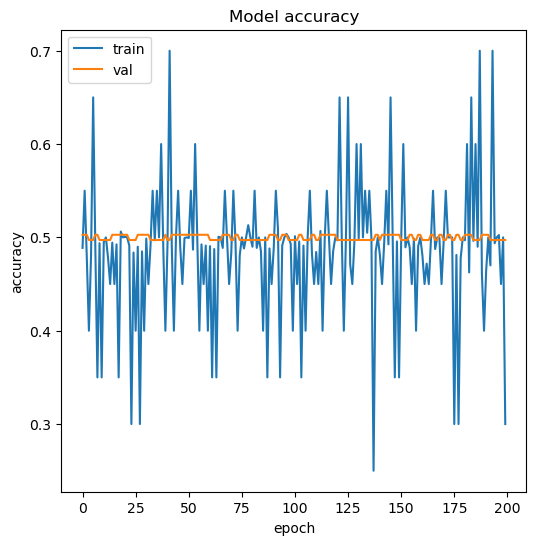

In [40]:
plot_and_save_graph(history)

In [41]:
cm_plot_labels = ['Normal', 'Hacked']

In [42]:
output_folder = 'Classification_report'
type = 'txt'

# Define the function to plot and save classification report
def plot_and_save_report(y_true, y_pred):
    base_name = 'report_' + nome

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    report = classification_report(y_true, y_pred, target_names=cm_plot_labels)
    print(report)

    with open(output_path, 'w') as f:
        f.write(report)

In [43]:
plot_and_save_report(y_true, y_pred)

              precision    recall  f1-score   support

      Normal       0.50      1.00      0.66        89
      Hacked       0.00      0.00      0.00        90

    accuracy                           0.50       179
   macro avg       0.25      0.50      0.33       179
weighted avg       0.25      0.50      0.33       179



/home/user/miniconda3/envs/tf_gpu/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/user/miniconda3/envs/tf_gpu/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/user/miniconda3/envs/tf_gpu/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()

In [44]:
output_folder = 'Confusion_matrix'
type = 'png'

# Define the flot confusion matrix
def plot_and_matrix(y_true, y_pred, cm_plot_labels):
    base_name = 'matrix_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    cm = confusion_matrix(y_true=y_true, y_pred=y_pred)

    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.xticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    plt.yticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    
    plt.savefig(output_path)

    plt.show()

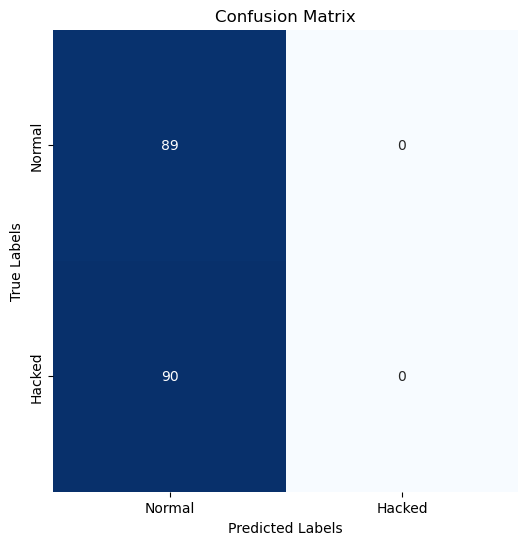

In [45]:
plot_and_matrix(y_true, y_pred, cm_plot_labels)

In [46]:
def plot_preds(X_test, y_true, y_pred):
    total_images = len(X_test)
    images_per_figure = 100
    cols = 5
    rows = (images_per_figure + cols - 1) // cols
    font_style = {'fontsize': 12, 'fontweight': 'bold'}

    for start in range(0, total_images, images_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + images_per_figure, total_images)

        for i in range(start, end):
            actual = 'Normal' if y_true[i] == 0 else 'Hacked'

            plt.subplot(rows, cols, i - start + 1)
            plt.title(f"Predict: {y_pred[i]} - {predictions[i][y_pred[i]] * 100:.2f}%\nActual: {y_true[i]} ({actual})", fontdict=font_style, color=('green' if y_pred[i] == y_true[i] else 'red'))
            plt.imshow(X_test[i], cmap='gray')
            plt.axis('off')

        plt.tight_layout()
        plt.show()

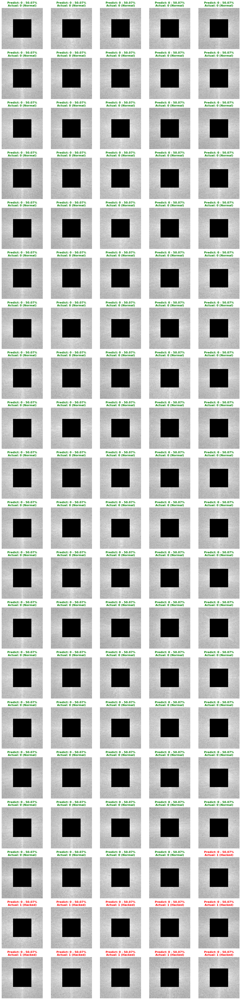

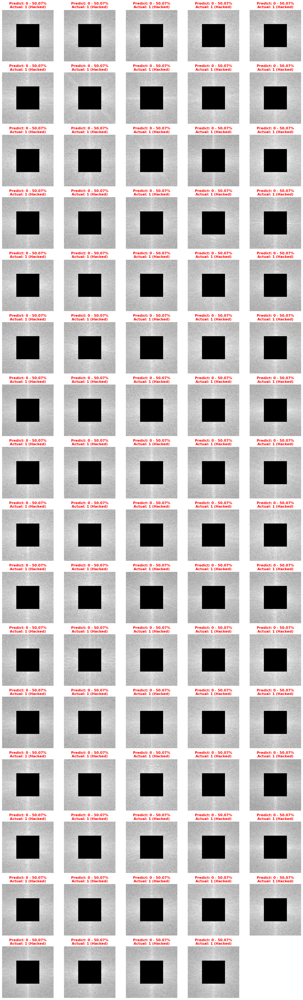

In [47]:
plot_preds(all_test_specs, y_true, y_pred)

In [48]:
# GC collect
gc.collect()

190752